In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Recebendo inputs do kaggle e separando em pastas

In [2]:
import os

# Caminhos para as pastas
train_color_dir = "/kaggle/working/train_color"
train_gray_dir = "/kaggle/working/train_gray"
val_color_dir = "/kaggle/working/val_color"
val_gray_dir = "/kaggle/working/val_gray"

# Função para criar pastas, se elas não existirem
def create_folders():
    os.makedirs(train_color_dir, exist_ok=True)
    os.makedirs(train_gray_dir, exist_ok=True)
    os.makedirs(val_color_dir, exist_ok=True)
    os.makedirs(val_gray_dir, exist_ok=True)

# Criar pastas
create_folders()

print("Pastas criadas com sucesso!")


Pastas criadas com sucesso!


In [3]:

import os
import shutil
from sklearn.model_selection import train_test_split

# Caminhos para as pastas
color_dir = "/kaggle/input/landscape-image-colorization/landscape Images/color"
gray_dir = "/kaggle/input/landscape-image-colorization/landscape Images/gray"
train_color_dir = "/kaggle/working/train_color"
train_gray_dir = "/kaggle/working/train_gray"
val_color_dir = "/kaggle/working/val_color"
val_gray_dir = "/kaggle/working/val_gray"

# Listar imagens (assumindo que os pares têm o mesmo nome de arquivo)
color_images = sorted(os.listdir(color_dir))
gray_images = sorted(os.listdir(gray_dir))

# Extraindo nomes dos arquivos (sem a extensão)
image_names = [os.path.splitext(img)[0] for img in color_images]

# Dividir em treino e validação (usando 20% para validação, por exemplo)
train_names, val_names = train_test_split(image_names, test_size=0.2, random_state=42)

# Função para mover arquivos
def copy_images(image_names, src_color_dir, src_gray_dir, dst_color_dir, dst_gray_dir):
    for name in image_names:
        shutil.copy(os.path.join(src_color_dir, f"{name}.jpg"), os.path.join(dst_color_dir, f"{name}.jpg"))
        shutil.copy(os.path.join(src_gray_dir, f"{name}.jpg"), os.path.join(dst_gray_dir, f"{name}.jpg"))

# Mover os arquivos
copy_images(train_names, color_dir, gray_dir, train_color_dir, train_gray_dir)
copy_images(val_names, color_dir, gray_dir, val_color_dir, val_gray_dir)

print("Imagens copiadas com sucesso!")


Imagens copiadas com sucesso!


Importando dependências

In [4]:
# Importe pacotes

import os
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import random
import shutil

Preparando imagens

In [5]:
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image

# Definindo transformações para as imagens
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Redimensiona as imagens para um tamanho fixo
    transforms.ToTensor()  # Converte as imagens para tensores
])

# Classe customizada para carregar as imagens
class CustomDataset(Dataset):
    def __init__(self, gray_dir, color_dir, image_names, transform=None):
        self.gray_dir = gray_dir
        self.color_dir = color_dir
        self.image_names = image_names
        self.transform = transform

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        gray_image_path = os.path.join(self.gray_dir, f"{self.image_names[idx]}.jpg")
        color_image_path = os.path.join(self.color_dir, f"{self.image_names[idx]}.jpg")

        gray_image = Image.open(gray_image_path).convert("L")
        color_image = Image.open(color_image_path).convert("RGB")

        if self.transform:
            gray_image = self.transform(gray_image)
            color_image = self.transform(color_image)

        return gray_image, color_image

# Criando datasets
train_dataset = CustomDataset(train_gray_dir, train_color_dir, train_names, transform=transform)
val_dataset = CustomDataset(val_gray_dir, val_color_dir, val_names, transform=transform)

# Criando DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=True, num_workers=4, pin_memory=True)

print("DataLoaders criados com sucesso!")

DataLoaders criados com sucesso!


Definindo Gerador

In [6]:
# U-Net

import torch
import torch.nn as nn
import torch.nn.functional as F

class UNet(nn.Module):
    def __init__(self, image_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1):
        super(UNet, self).__init__()

        self.image_dim = image_dim  # Dimensões da imagem de entrada (C, H, W)
        self.depth = depth 
        self.n_channels = n_channels
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.conv_padding = conv_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.pool_padding = pool_padding
        self.transpose_kernel_size = transpose_kernel_size
        self.transpose_stride = transpose_stride
        self.transpose_padding = transpose_padding
        
        # To RGB
        self.to_rgb = nn.Conv2d(1, 3, kernel_size=1)

        # Encoder
        self.encoders = nn.ModuleList([self.conv_block(3 if i == 0 else self.n_channels * (2 ** (i-1)), self.n_channels * (2 ** i)) for i in range(self.depth)])
        self.pool = nn.MaxPool2d(kernel_size=self.pool_kernel_size, stride=self.pool_stride, padding=self.pool_padding)

        # Bottleneck
        self.bottleneck = self.conv_block(self.n_channels * (2 ** (self.depth-1)), self.n_channels * (2 ** self.depth))

        # Decoder
        self.decoders = nn.ModuleList([self.conv_transpose(self.n_channels * (2 ** (i+2)), self.n_channels * (2 ** i)) for i in range(self.depth-2, -1, -1)])

        # Final conv layer
        self.final_conv = nn.Conv2d(self.n_channels, 3, kernel_size=1)

    def conv_block(self, in_channels, out_channels):
        # Camada convolucional com normalização e função de ativação; 2 vezes
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),  # Normalização para acelerar o treinamento
            nn.ReLU(inplace=True),  # Função de ativação (zera os valores negativos)
            nn.Conv2d(out_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def crop(self, encoder_feature, decoder_feature):
        _, _, h, w = decoder_feature.size()
        encoder_feature = F.interpolate(encoder_feature, size=(h, w), mode='bilinear', align_corners=False)  # Redimensiona a feature map do encoder
        return encoder_feature

    def conv_transpose(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=self.transpose_kernel_size, stride=self.transpose_stride, padding=self.transpose_padding),
            self.conv_block(out_channels, out_channels)
        )
    
    def forward(self, x):
        #print(f"Input shape: {x.shape}")
        encoders_features = []

        # RGB pass
        x = self.to_rgb(x)
        #print(f"After RGB pass: {x.shape}")

        # Encoder pass
        for idx, encoder in enumerate(self.encoders):
            #print("idx: ", idx)
            #print("encoder: ", encoder)
            x = encoder(x)
            encoders_features.append(x)
            #print(f"After encoder block {idx+1}: {x.shape}")
            x = self.pool(x)
            #print(f"After pooling {idx+1}: {x.shape}")

        # Bottleneck
        x = self.bottleneck(x)
        #print(f"After bottleneck: {x.shape}")
        # Doubled the block
        #print("Starting decoder pass")
        # Decoder pass
        for i, decoder in enumerate(self.decoders):
            #print("i: ", i)
            #print("decoder: ", decoder)
            encoder_feature = encoders_features[-(i+1)]
            encoder_feature = self.crop(encoder_feature, x)  # Aplica o crop nas feature maps
            #print(f"Encoder feature {i+1} after crop: {encoder_feature.shape}")

            if i != 0:
                x = torch.cat([encoder_feature, x], dim=1)  # Concatena encoder com decoder
                #print(f"After concatenation with encoder feature {i+1}: {x.shape}")

            x = decoder(x)

        # Final convolution
        x = self.final_conv(x)
        try:
            x = F.interpolate(x, size=(self.image_dim[2], self.image_dim[3]), mode='bilinear', align_corners=False)
        except:
            print(self.image_dim)
            raise
        #print(f"Output shape after final convolution: {x.shape}")
        
        x = torch.sigmoid(x)
        
        return x

Testando gerador

Gerador gera uma imagem do tamanho desejado, passando pela unet

Discriminador

In [7]:

class Discriminator(nn.Module):
    def __init__(self, image_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1):
        super().__init__()

        self.image_dim = image_dim  # Dimensões da imagem de entrada (C, H, W)
        self.depth = depth 
        self.n_channels = n_channels
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.conv_padding = conv_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.pool_padding = pool_padding
        self.transpose_kernel_size = transpose_kernel_size
        self.transpose_stride = transpose_stride
        self.transpose_padding = transpose_padding

        # Encoder
        self.encoders = nn.ModuleList([self.conv_block(3 if i == 0 else self.n_channels * (2 ** (i-1)), self.n_channels * (2 ** i)) for i in range(self.depth)])
        self.pool = nn.MaxPool2d(kernel_size=self.pool_kernel_size, stride=self.pool_stride, padding=self.pool_padding)

        # Bottleneck
        self.bottleneck = self.conv_block(self.n_channels * (2 ** (self.depth-1)), self.n_channels * (2 ** self.depth))

        # Final conv layer
        self.final_conv = nn.Conv2d(self.n_channels * (2 ** self.depth), 1, kernel_size=1)

        # Fully connected layer to reduce the dimensions to [32, 1, 1, 1]
        self.fc = nn.Linear(self.image_dim[2] * self.image_dim[3], 1)

    def conv_block(self, in_channels, out_channels):
        # Camada convolucional com normalização e função de ativação; 2 vezes
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),  # Normalização para acelerar o treinamento
            nn.ReLU(inplace=True)  # Função de ativação (zera os valores negativos)
        )
    
        """
            nn.Conv2d(out_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        """

    def crop(self, encoder_feature, decoder_feature):
        _, _, h, w = decoder_feature.size()
        encoder_feature = F.interpolate(encoder_feature, size=(h, w), mode='bilinear', align_corners=False)  # Redimensiona a feature map do encoder
        return encoder_feature

    def conv_transpose(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=self.transpose_kernel_size, stride=self.transpose_stride, padding=self.transpose_padding),
            self.conv_block(out_channels, out_channels)
        )
    
    def forward(self, x):
        #print(f"Input shape: {x.shape}")
        encoders_features = []

        # Encoder pass
        for idx, encoder in enumerate(self.encoders):
            #print("idx: ", idx)
            #print("encoder: ", encoder)
            x = encoder(x)
            encoders_features.append(x)
            #print(f"After encoder block {idx+1}: {x.shape}")
            x = self.pool(x)
            #print(f"After pooling {idx+1}: {x.shape}")

        # Bottleneck
        x = self.bottleneck(x)
        #print(f"After bottleneck: {x.shape}")
        # Doubled the block
        #print("Starting decoder pass")

        # Final convolution
        x = self.final_conv(x)
        x = F.interpolate(x, size=(1, 1), mode='bilinear', align_corners=False)
        #print(f"Output shape after final convolution: {x.shape}")
        x = torch.sigmoid(x)


        return x

Treino

In [8]:
from torch.optim import Adam
from torch.nn import BCELoss, L1Loss, MSELoss
import time

# Loss para o discriminador
d_loss = BCELoss()

class GeneratorLoss(nn.Module):
    def __init__(self, lambda_l1=100):
        super(GeneratorLoss, self).__init__()
        # Definir a perda BCE (usada para a parte adversária)
        self.adversarial_loss = nn.MSELoss()
        # Definir a perda L1
        self.l1_loss = nn.L1Loss()
        # Peso da perda L1
        self.lambda_l1 = lambda_l1

    def forward(self, yhat_fake, fake_images, real_images):
        """
        Parâmetros:
        - yhat_fake: As previsões do discriminador sobre as imagens geradas (fake)
        - fake_images: Imagens geradas pelo gerador
        - real_images: Imagens reais de referência
        
        Retorna:
        - A perda total combinando perda adversária e L1
        """
        # Perda adversária: tentar fazer o discriminador acreditar que as imagens geradas são reais
        adversarial_loss = self.adversarial_loss(yhat_fake, torch.ones_like(yhat_fake))
        
        # Perda L1: minimizar a diferença entre as imagens geradas e as reais
        l1_loss = self.l1_loss(fake_images, real_images)
        
        # Perda total: adversária + ponderação da perda L1
        total_loss = adversarial_loss + self.lambda_l1 * l1_loss
        
        return total_loss

g_loss = GeneratorLoss()
#g_loss = CycleGANLoss()

# Normalize the input values to be between 0 and 1
def normalize(tensor):
    return (tensor - tensor.min()) / (tensor.max() - tensor.min())


In [9]:
class PaisagemGAN(nn.Module):
    def __init__(self, generator, discriminator):
        super(PaisagemGAN, self).__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.global_step = 0

    def compile(self, g_loss, d_loss):
        self.g_loss = g_loss
        self.d_loss = d_loss
        self.g_opt = Adam(self.generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
        self.d_opt = Adam(self.discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

    def train_step(self, real_images, grey_images):
        
        # Train the discriminator
        #inicio = time.time()
        self.d_opt.zero_grad()
        
        fake_images = self.generator(grey_images)
        yhat_real = self.discriminator(real_images)
        yhat_fake = self.discriminator(fake_images)
        
        # Suavização de rótulos para imagens reais (usando 0.9 ao invés de 1.0)
        d_loss_real = self.d_loss(yhat_real, torch.full_like(yhat_real, 0.9))
        # Suavização opcional de rótulos para imagens falsas (usando 0.1 ao invés de 0.0)
        d_loss_fake = self.d_loss(yhat_fake, torch.full_like(yhat_fake, 0.1))
        # Soma das perdas
        total_d_loss = d_loss_real + d_loss_fake
        total_d_loss.backward()
        
        # Update discriminator weights every 5 steps
        if self.global_step % 10 == 9:
            self.d_opt.step()
        
        self.global_step += 1
        #fim = time.time()
        #print(fim - inicio)

        # Train the generator
        #inicio = time.time()
        self.g_opt.zero_grad()
        
        fake_images = self.generator(grey_images)
        yhat_fake = self.discriminator(fake_images)
        total_g_loss = self.g_loss(yhat_fake, fake_images, real_images)
        
        total_g_loss.backward()
        self.g_opt.step()
        #fim = time.time()
        #print(fim - inicio)
        
        return {'d_loss': total_d_loss.item(), 'g_loss': total_g_loss.item(), 'gen': fake_images}

Realizar treinamento

In [10]:
nex = next(iter(train_loader))
img_dim = nex[0].shape
print(img_dim)

gene = UNet(image_dim=img_dim, n_channels=64, depth=3, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1)
# Configurando o dispositivo (GPU, se disponível)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Dispositivo: {device}")
gene = gene.to(device)  # Mover o modelo para o dispositivo

disc = Discriminator(image_dim=img_dim, n_channels=64, depth=2, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1)
# Configurando o dispositivo (GPU, se disponível)
#device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Dispositivo: {device}")
disc = disc.to(device)  # Mover o modelo para o dispositivo

torch.Size([16, 1, 256, 256])
Dispositivo: cuda
Dispositivo: cuda


In [11]:
def save_checkpoint(model, optimizer, epoch, batch, loss, filepath='checkpoint.pth'):
    checkpoint = {
        'epoch': epoch,
        'batch': batch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss
    }
    torch.save(checkpoint, filepath)

Iniciar treinamento
Epoch [1/100], d_loss: 1.2681, g_loss: 7.5514, val_loss: 7.1656
196.12908101081848


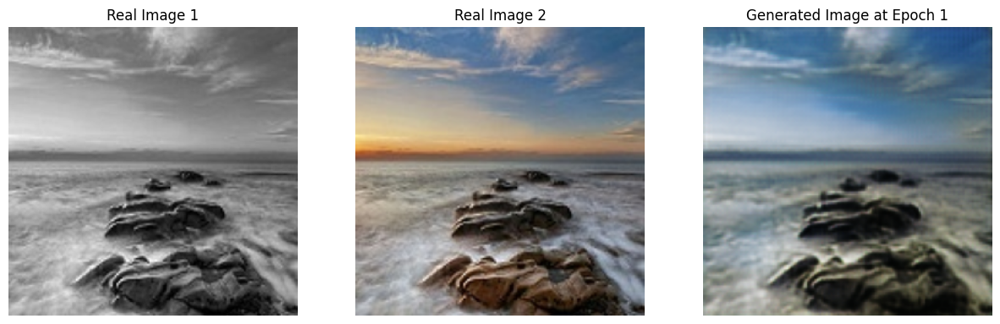

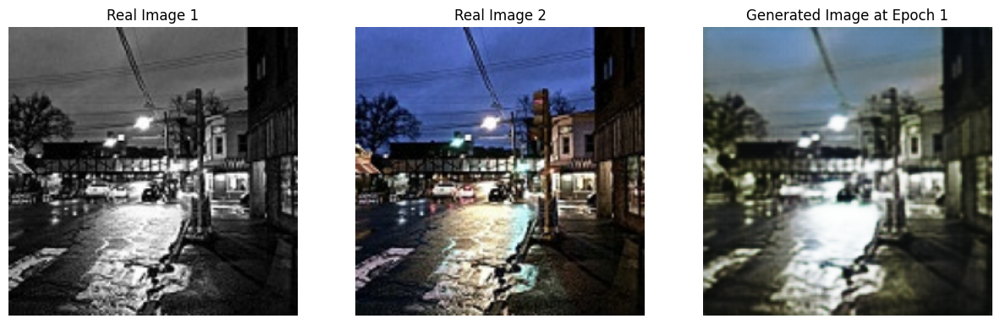

Epoch [2/100], d_loss: 1.0575, g_loss: 7.5871, val_loss: 7.2731
195.11317467689514
Epoch [3/100], d_loss: 1.0079, g_loss: 8.6553, val_loss: 6.8841
195.02875995635986
Epoch [4/100], d_loss: 1.0298, g_loss: 8.6737, val_loss: 6.5080
195.028258562088
Epoch [5/100], d_loss: 1.0536, g_loss: 7.1918, val_loss: 6.6139
194.9089138507843


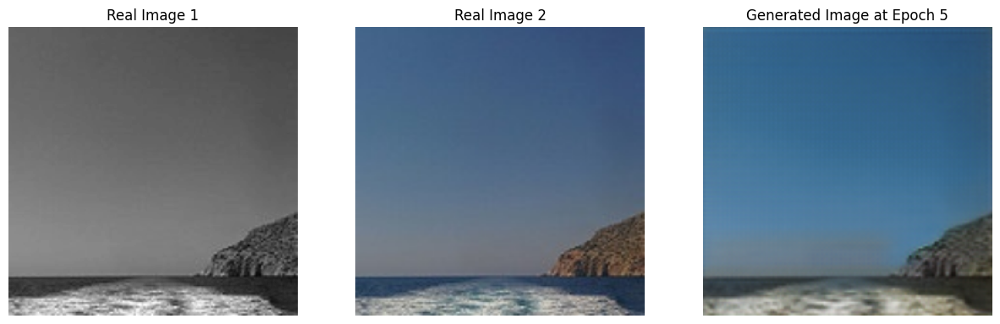

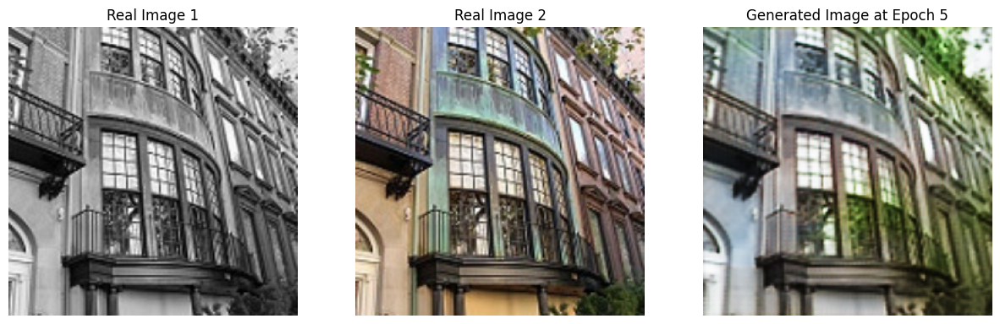

Epoch [6/100], d_loss: 0.9123, g_loss: 7.2199, val_loss: 6.5577
194.9011549949646
Epoch [7/100], d_loss: 0.8074, g_loss: 6.7646, val_loss: 6.3266
194.91070914268494
Epoch [8/100], d_loss: 0.8524, g_loss: 5.7593, val_loss: 6.1858
194.95226120948792
Epoch [9/100], d_loss: 1.0588, g_loss: 6.6511, val_loss: 6.8314
195.04048538208008
Epoch [10/100], d_loss: 0.9986, g_loss: 6.3982, val_loss: 6.4069
195.04096245765686


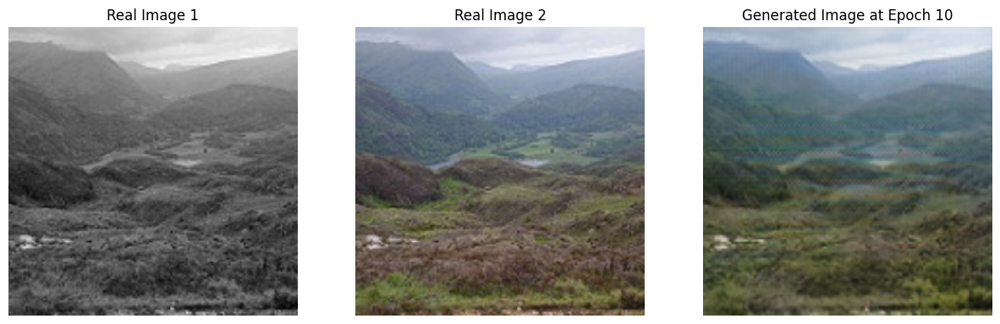

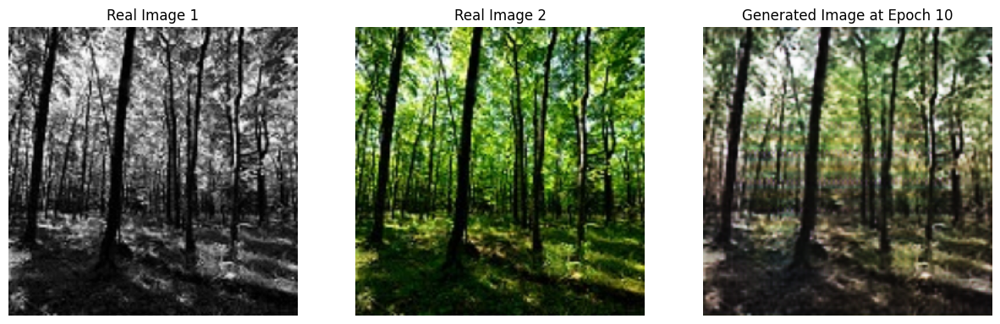

Epoch [11/100], d_loss: 0.8857, g_loss: 7.0662, val_loss: 6.3470
195.13363552093506
Epoch [12/100], d_loss: 0.7650, g_loss: 7.1940, val_loss: 6.4765
195.24184012413025
Epoch [13/100], d_loss: 0.7278, g_loss: 6.3089, val_loss: 6.3081
195.16289973258972
Epoch [14/100], d_loss: 0.7070, g_loss: 6.3123, val_loss: 6.3481
195.06076765060425
Epoch [15/100], d_loss: 0.8370, g_loss: 6.4243, val_loss: 6.1349
194.94937372207642


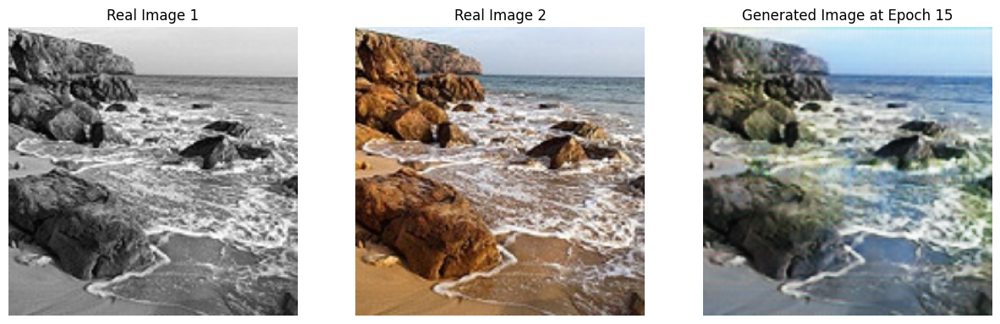

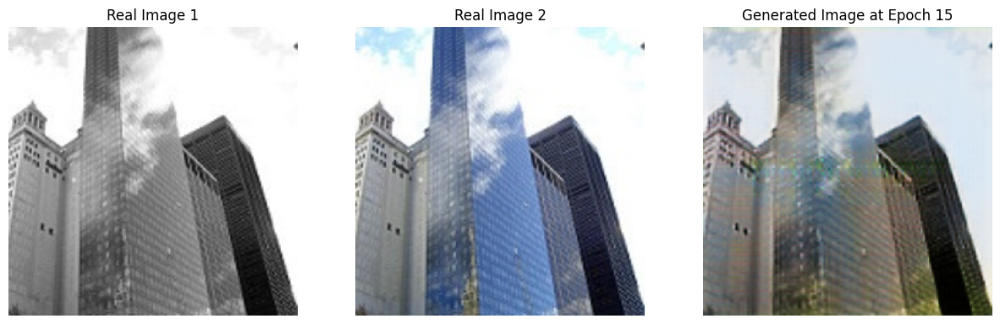

Epoch [16/100], d_loss: 0.8593, g_loss: 5.6936, val_loss: 6.1906
194.89258861541748
Epoch [17/100], d_loss: 0.9137, g_loss: 5.7456, val_loss: 5.9126
194.94106721878052
Epoch [18/100], d_loss: 1.1168, g_loss: 6.2050, val_loss: 5.9904
194.993816614151
Epoch [19/100], d_loss: 0.9903, g_loss: 5.2008, val_loss: 6.0388
194.98959875106812
Epoch [20/100], d_loss: 1.0880, g_loss: 7.3910, val_loss: 6.0042
194.9340238571167


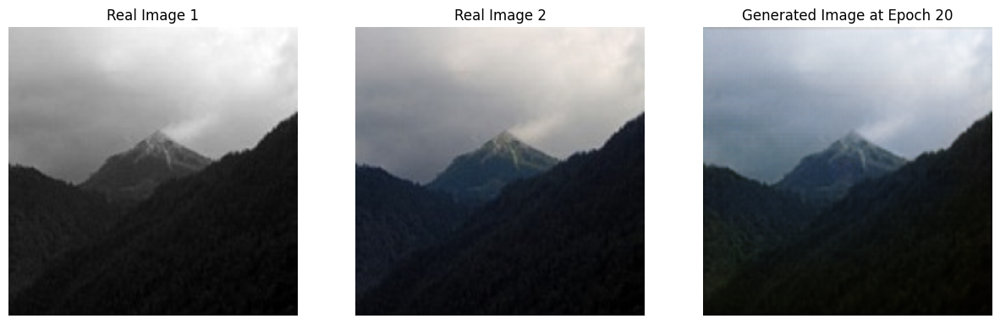

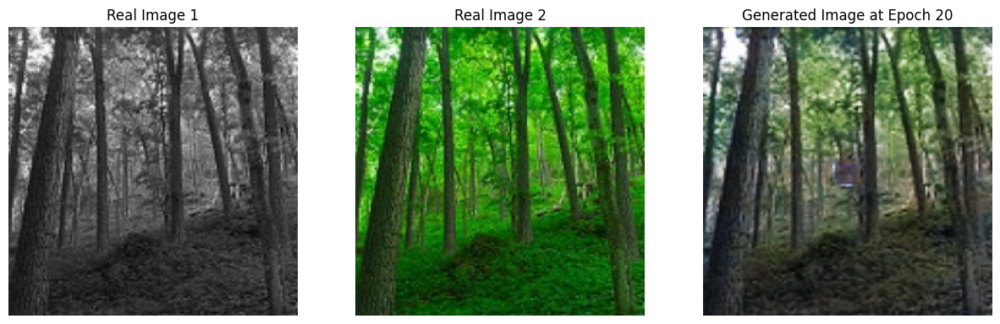

Epoch [21/100], d_loss: 0.9706, g_loss: 8.5938, val_loss: 6.2236
194.98273396492004
Epoch [22/100], d_loss: 0.9816, g_loss: 6.2341, val_loss: 6.5860
194.95174598693848
Epoch [23/100], d_loss: 1.0906, g_loss: 4.7189, val_loss: 5.9946
194.99101209640503
Epoch [24/100], d_loss: 0.8379, g_loss: 4.9623, val_loss: 5.7917
195.06506156921387
Epoch [25/100], d_loss: 0.9479, g_loss: 7.4148, val_loss: 6.1557
194.9735324382782


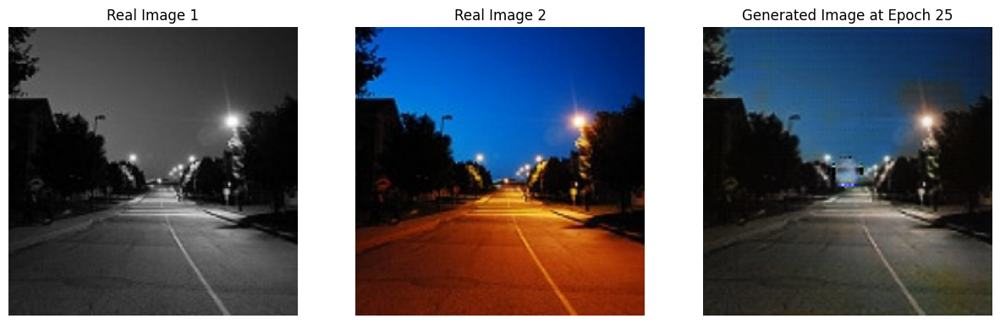

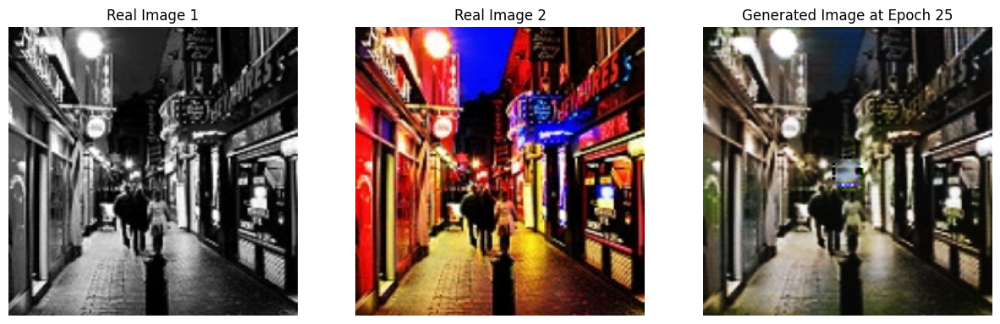

Epoch [26/100], d_loss: 0.8669, g_loss: 5.2768, val_loss: 5.9630
194.9231345653534
Epoch [27/100], d_loss: 1.0086, g_loss: 4.9277, val_loss: 5.6950
194.88819909095764
Epoch [28/100], d_loss: 0.9074, g_loss: 6.0228, val_loss: 6.2760
194.95758628845215
Epoch [29/100], d_loss: 1.1613, g_loss: 4.6007, val_loss: 5.8469
194.97461915016174
Epoch [30/100], d_loss: 1.0324, g_loss: 4.9521, val_loss: 5.9949
194.9548065662384


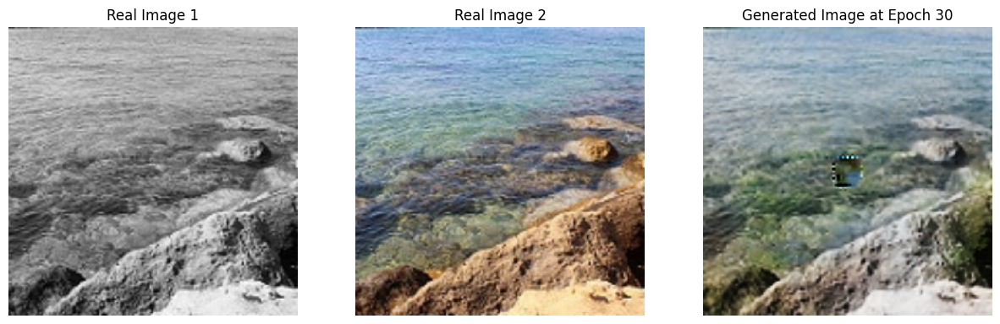

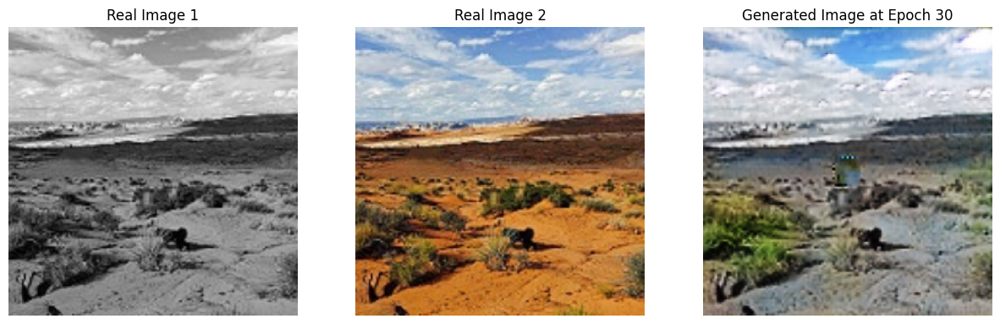

Epoch [31/100], d_loss: 0.9385, g_loss: 6.8591, val_loss: 6.0026
195.2202537059784
Epoch [32/100], d_loss: 0.7385, g_loss: 6.5716, val_loss: 6.1239
194.9658601284027
Epoch [33/100], d_loss: 0.8231, g_loss: 5.5901, val_loss: 5.9588
194.88428473472595
Epoch [34/100], d_loss: 0.8906, g_loss: 5.3328, val_loss: 5.8027
194.93341875076294
Epoch [35/100], d_loss: 0.8418, g_loss: 6.7446, val_loss: 5.9522
194.9301085472107


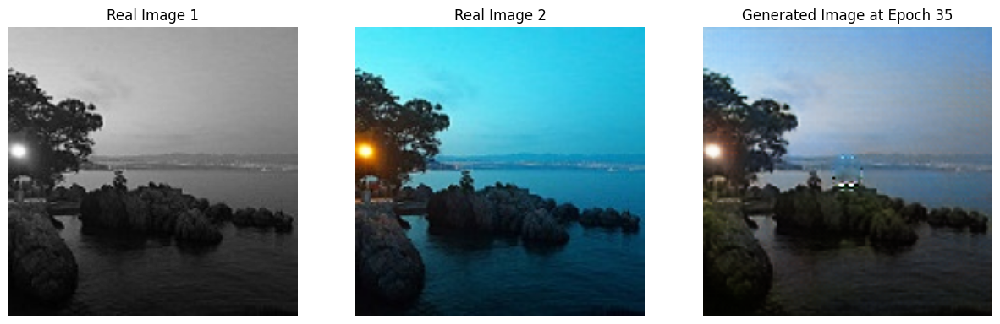

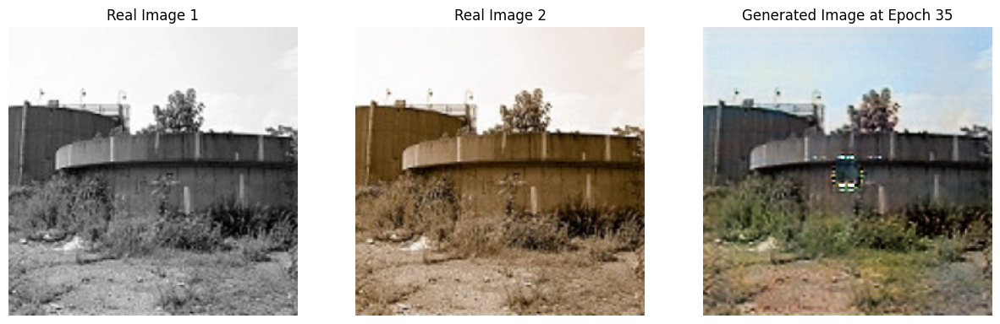

Epoch [36/100], d_loss: 1.0504, g_loss: 4.7558, val_loss: 5.9334
195.15637159347534
Epoch [37/100], d_loss: 0.8867, g_loss: 5.3727, val_loss: 5.8541
194.98187804222107
Epoch [38/100], d_loss: 0.7903, g_loss: 5.6116, val_loss: 5.8172
194.89216494560242
Epoch [39/100], d_loss: 0.7603, g_loss: 5.5071, val_loss: 6.4011
194.93139243125916
Epoch [40/100], d_loss: 0.8040, g_loss: 8.4902, val_loss: 5.7076
194.88644528388977


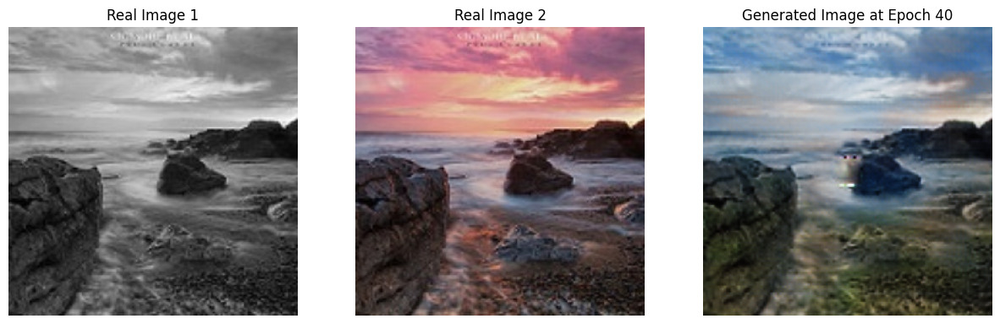

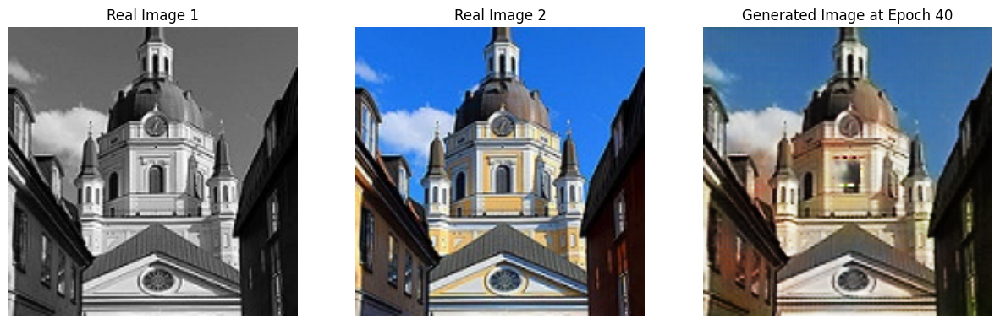

Epoch [41/100], d_loss: 0.7316, g_loss: 7.2394, val_loss: 5.9248
194.91804361343384
Epoch [42/100], d_loss: 0.9272, g_loss: 7.1706, val_loss: 6.0211
194.97552609443665
Epoch [43/100], d_loss: 1.1203, g_loss: 5.6177, val_loss: 6.1100
194.8320472240448
Epoch [44/100], d_loss: 0.9280, g_loss: 5.9122, val_loss: 5.7733
194.92647337913513
Epoch [45/100], d_loss: 1.0255, g_loss: 5.9528, val_loss: 6.0067
194.9689905643463


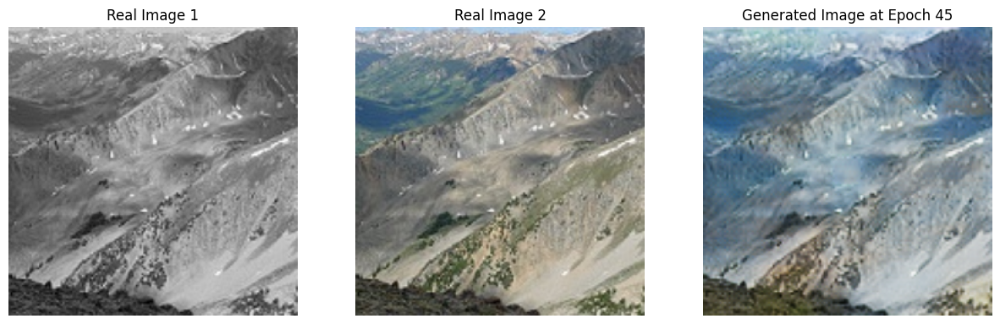

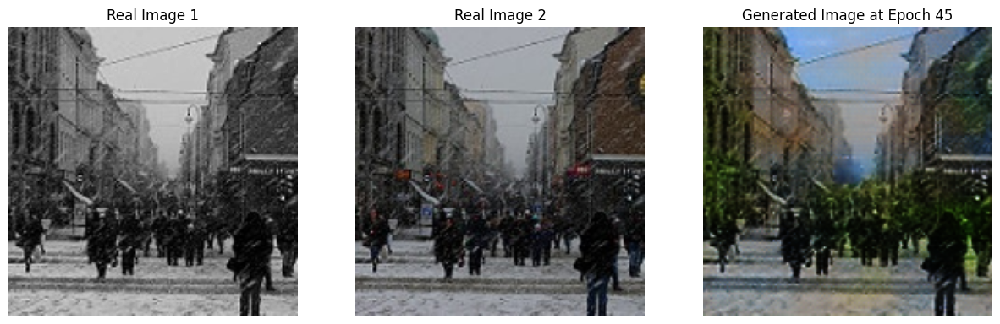

Epoch [46/100], d_loss: 0.7116, g_loss: 5.3786, val_loss: 5.9191
195.09908485412598
Epoch [47/100], d_loss: 1.0949, g_loss: 5.8897, val_loss: 6.1111
194.9266710281372
Epoch [48/100], d_loss: 1.1486, g_loss: 4.8838, val_loss: 5.9184
194.87851977348328
Epoch [49/100], d_loss: 0.8009, g_loss: 6.2345, val_loss: 6.0706
194.92004823684692
Epoch [50/100], d_loss: 0.9850, g_loss: 5.4338, val_loss: 6.0024
194.8766975402832


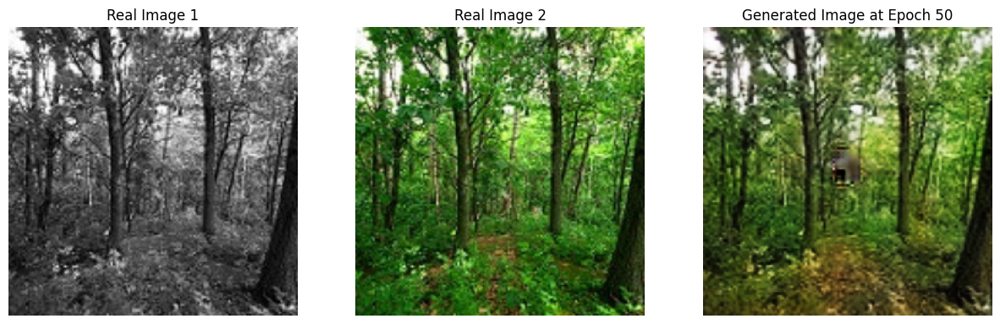

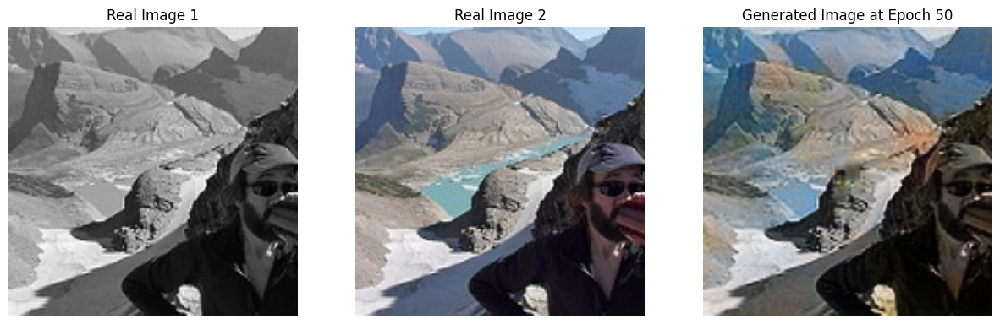

Epoch [51/100], d_loss: 0.7637, g_loss: 5.5891, val_loss: 5.9578
195.08153581619263
Epoch [52/100], d_loss: 0.9061, g_loss: 5.0922, val_loss: 5.8780
195.0045518875122
Epoch [53/100], d_loss: 0.7720, g_loss: 6.1280, val_loss: 6.0336
194.9151372909546
Epoch [54/100], d_loss: 0.8505, g_loss: 5.3770, val_loss: 5.9168
194.93339800834656
Epoch [55/100], d_loss: 0.7694, g_loss: 6.2829, val_loss: 6.0344
194.8684561252594


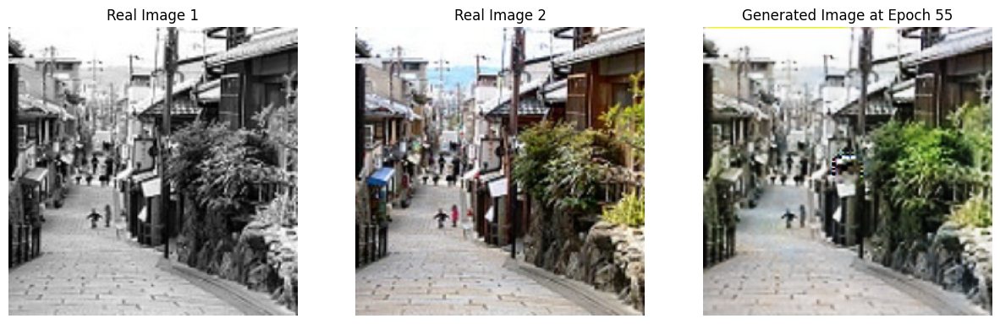

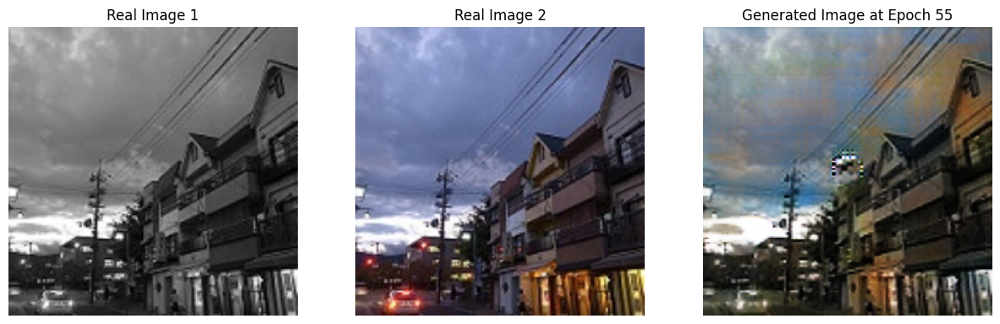

Epoch [56/100], d_loss: 1.2412, g_loss: 4.8050, val_loss: 5.8632
195.0100018978119
Epoch [57/100], d_loss: 0.8753, g_loss: 4.9037, val_loss: 6.0053
194.9054934978485
Epoch [58/100], d_loss: 0.8888, g_loss: 7.0719, val_loss: 5.9800
194.9835867881775
Epoch [59/100], d_loss: 0.7561, g_loss: 5.5280, val_loss: 5.8440
194.8143298625946
Epoch [60/100], d_loss: 1.0829, g_loss: 6.0808, val_loss: 6.1702
194.85121893882751


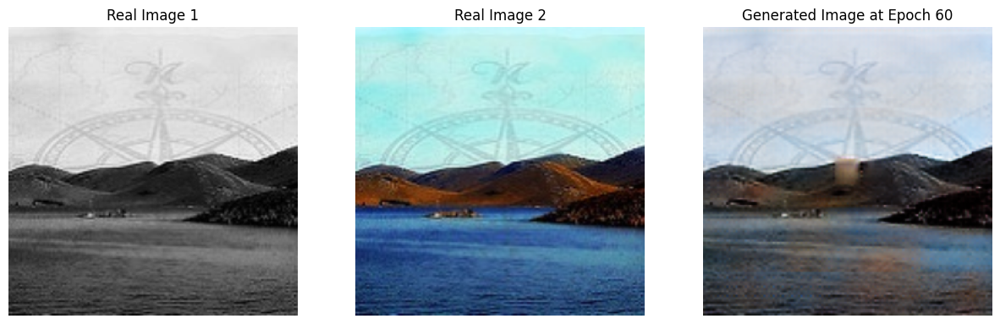

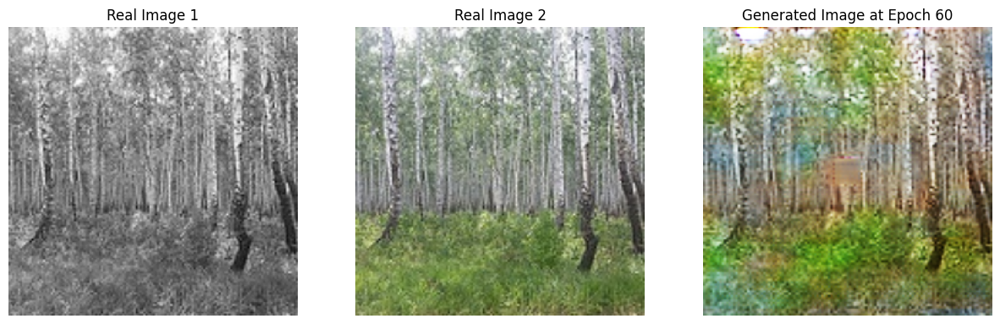

Epoch [61/100], d_loss: 1.0596, g_loss: 5.6720, val_loss: 5.8041
194.8946032524109
Epoch [62/100], d_loss: 0.8275, g_loss: 5.7869, val_loss: 6.0372
194.844806432724
Epoch [63/100], d_loss: 1.4865, g_loss: 4.4352, val_loss: 6.0364
194.83778142929077
Epoch [64/100], d_loss: 0.7210, g_loss: 4.8760, val_loss: 6.3101
194.83353519439697
Epoch [65/100], d_loss: 0.7833, g_loss: 5.2249, val_loss: 5.9052
194.84459352493286


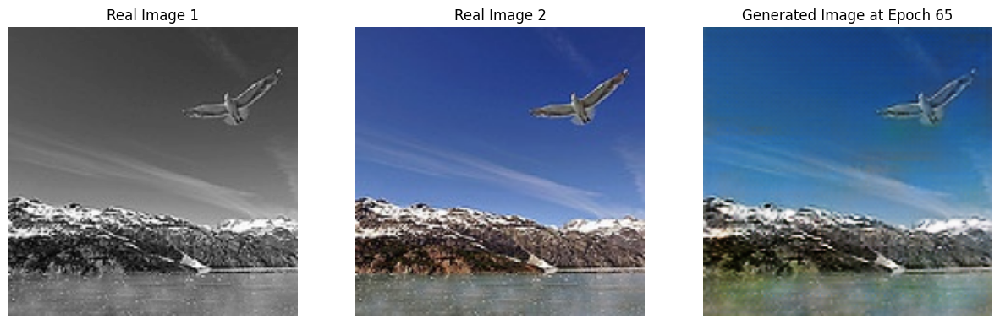

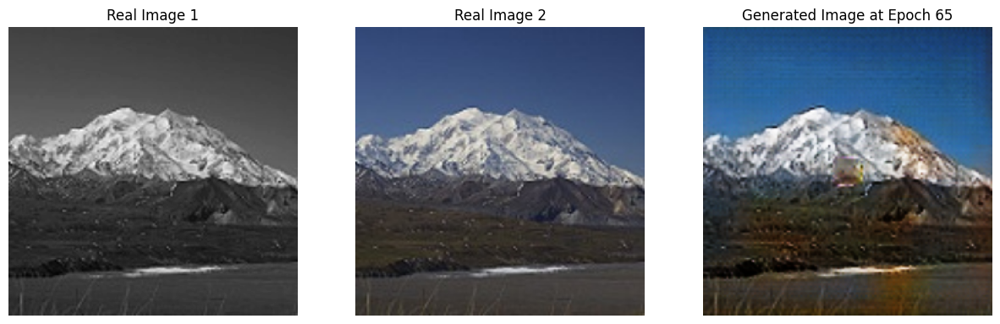

Epoch [66/100], d_loss: 0.7003, g_loss: 5.0926, val_loss: 6.1449
194.88818097114563
Epoch [67/100], d_loss: 0.7062, g_loss: 4.9076, val_loss: 5.9315
194.90008759498596
Epoch [68/100], d_loss: 0.8370, g_loss: 5.1875, val_loss: 6.3684
194.8710858821869
Epoch [69/100], d_loss: 0.7609, g_loss: 6.6159, val_loss: 6.2654
194.93314862251282
Epoch [70/100], d_loss: 0.7128, g_loss: 5.1532, val_loss: 6.0319
194.90689206123352


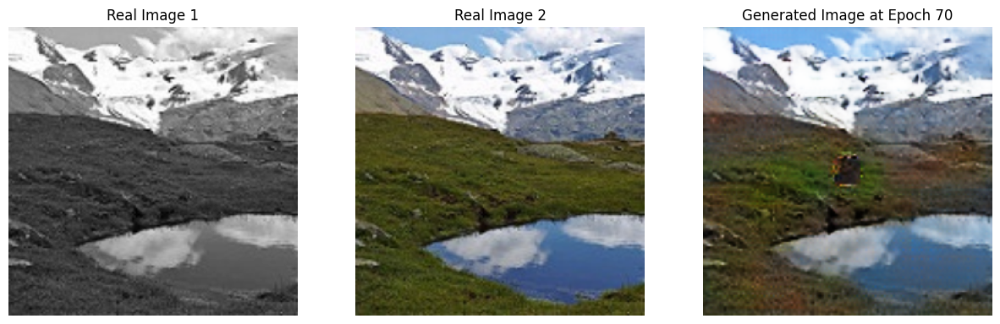

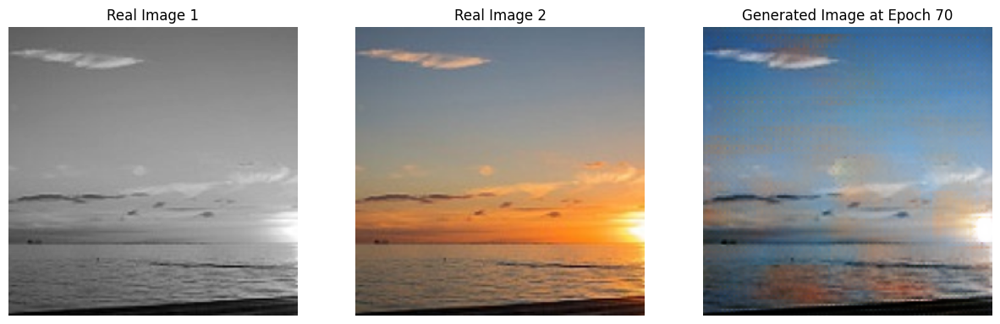

Epoch [71/100], d_loss: 0.6968, g_loss: 5.0013, val_loss: 6.0154
194.99829745292664
Epoch [72/100], d_loss: 0.7195, g_loss: 6.4246, val_loss: 6.2776
194.95609498023987
Epoch [73/100], d_loss: 0.6747, g_loss: 5.4739, val_loss: 6.0401
194.9187216758728
Epoch [74/100], d_loss: 0.7349, g_loss: 4.9705, val_loss: 6.3508
194.93757247924805
Epoch [75/100], d_loss: 0.8415, g_loss: 4.2003, val_loss: 6.0984
194.90773606300354


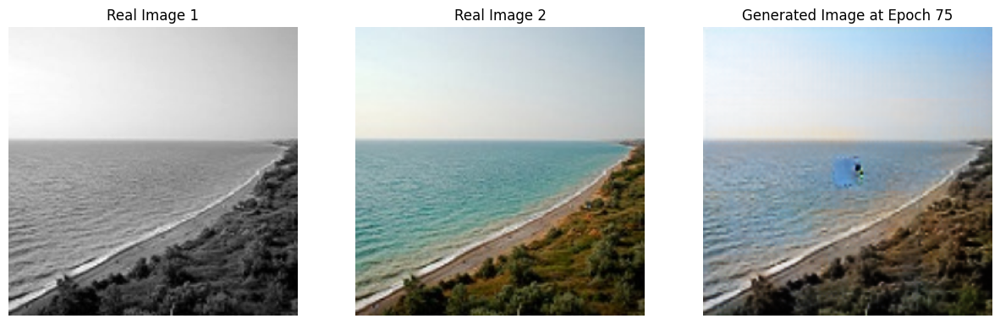

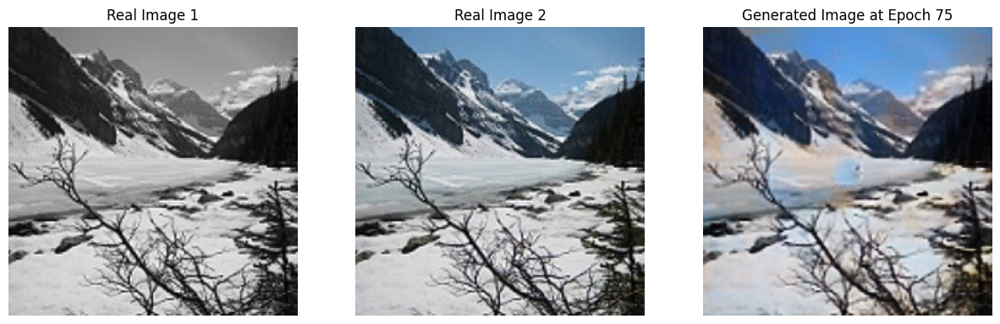

Epoch [76/100], d_loss: 0.8186, g_loss: 4.4213, val_loss: 5.9749
194.97199869155884
Epoch [77/100], d_loss: 0.8105, g_loss: 4.4816, val_loss: 5.9288
194.92466568946838
Epoch [78/100], d_loss: 0.6866, g_loss: 4.7587, val_loss: 6.0735
195.00191450119019
Epoch [79/100], d_loss: 0.7079, g_loss: 4.8480, val_loss: 5.9132
194.94794487953186
Epoch [80/100], d_loss: 0.8706, g_loss: 5.1660, val_loss: 6.2493
194.86403679847717


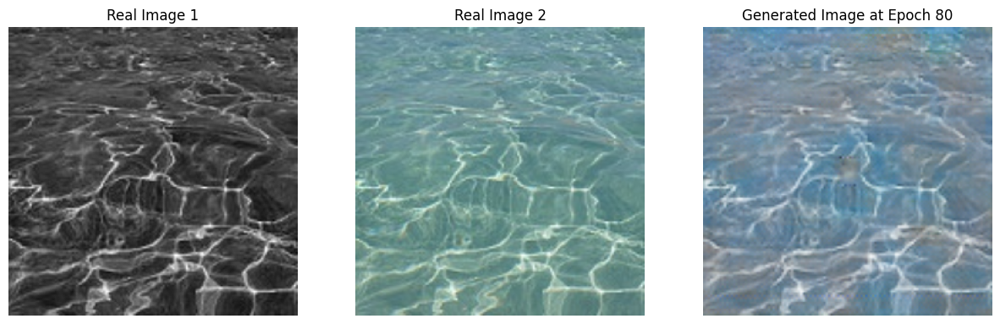

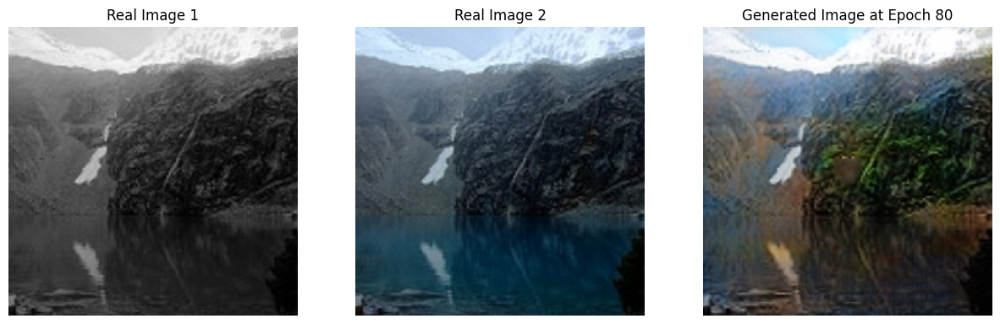

Epoch [81/100], d_loss: 0.7733, g_loss: 4.6792, val_loss: 6.2298
194.94469809532166
Epoch [82/100], d_loss: 0.6993, g_loss: 4.2268, val_loss: 6.0171
194.89666962623596
Epoch [83/100], d_loss: 0.7416, g_loss: 4.7923, val_loss: 6.0079
194.93168902397156
Epoch [84/100], d_loss: 0.7533, g_loss: 4.2452, val_loss: 5.8422
194.9608016014099
Epoch [85/100], d_loss: 0.6694, g_loss: 4.2200, val_loss: 5.9512
194.90654969215393


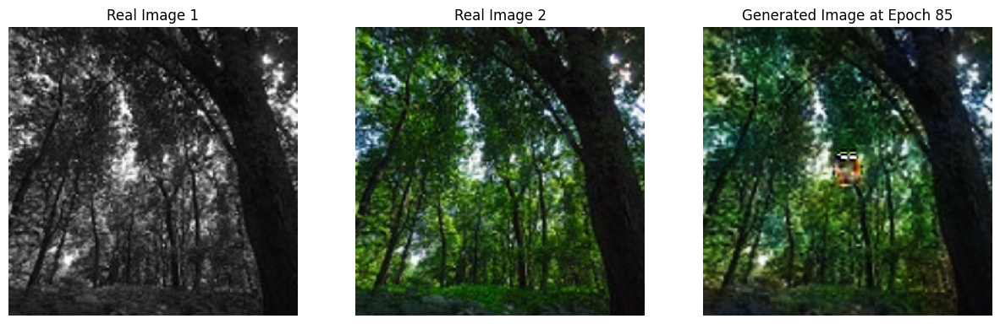

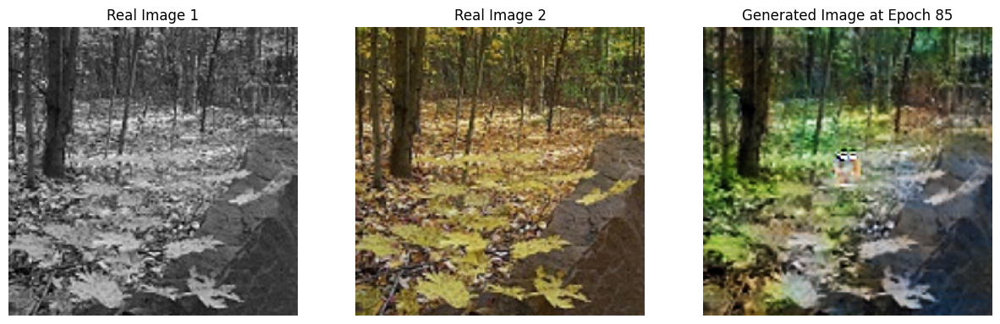

Epoch [86/100], d_loss: 0.6967, g_loss: 4.7241, val_loss: 6.2265
194.88517451286316
Epoch [87/100], d_loss: 0.7609, g_loss: 4.6142, val_loss: 6.1231
194.85320281982422
Epoch [88/100], d_loss: 0.6867, g_loss: 4.5691, val_loss: 6.0165
194.84756183624268
Epoch [89/100], d_loss: 0.7971, g_loss: 4.9427, val_loss: 6.1877
194.85236191749573
Epoch [90/100], d_loss: 0.7724, g_loss: 4.5348, val_loss: 6.0617
194.8537425994873


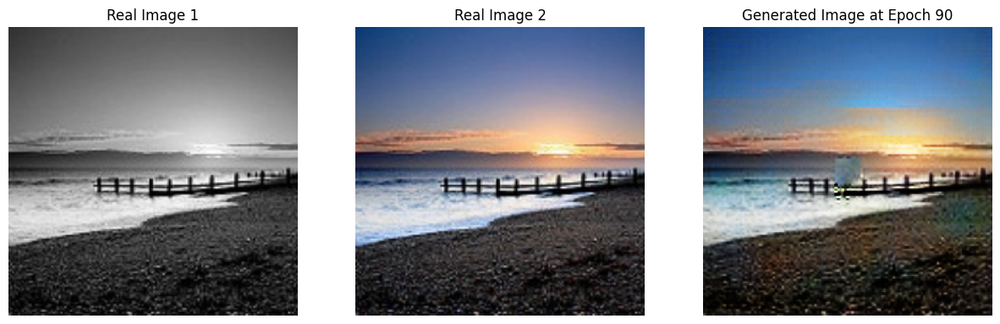

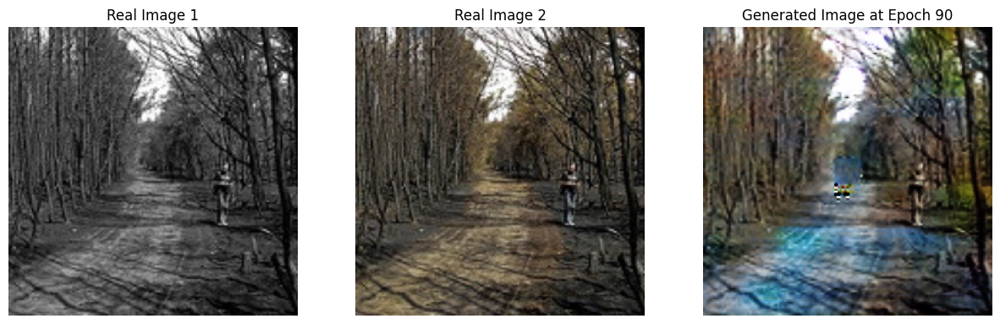

Epoch [91/100], d_loss: 0.6708, g_loss: 4.7785, val_loss: 6.0378
194.99663400650024
Epoch [92/100], d_loss: 0.7081, g_loss: 4.3131, val_loss: 5.8935
194.95220065116882
Epoch [93/100], d_loss: 0.7021, g_loss: 4.5190, val_loss: 6.1078
194.8456094264984
Epoch [94/100], d_loss: 0.7560, g_loss: 4.4666, val_loss: 6.2259
194.95562624931335
Epoch [95/100], d_loss: 0.7241, g_loss: 5.9075, val_loss: 6.3609
194.92302441596985


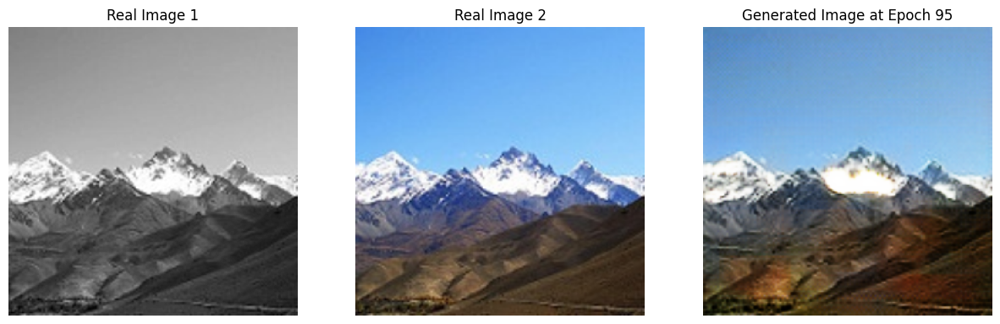

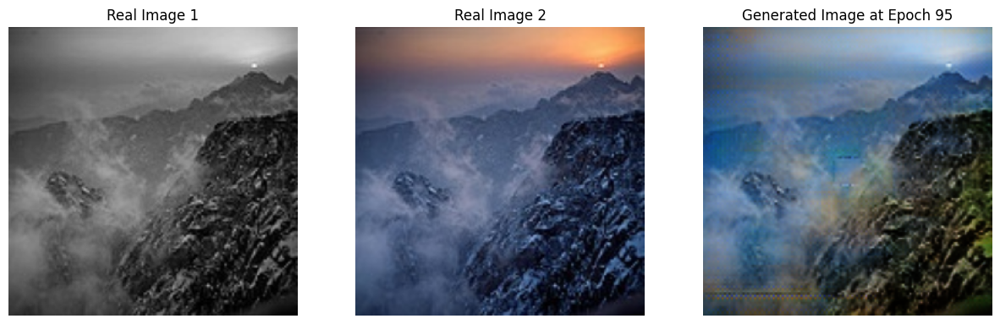

Epoch [96/100], d_loss: 0.7462, g_loss: 4.7971, val_loss: 6.0588
195.19505071640015
Epoch [97/100], d_loss: 0.6938, g_loss: 5.4453, val_loss: 6.1241
195.01339173316956
Epoch [98/100], d_loss: 0.6733, g_loss: 5.0764, val_loss: 6.1097
195.0318694114685
Epoch [99/100], d_loss: 0.6607, g_loss: 4.1551, val_loss: 6.0885
195.06958174705505
Epoch [100/100], d_loss: 0.6585, g_loss: 4.0290, val_loss: 6.0287
195.10113716125488


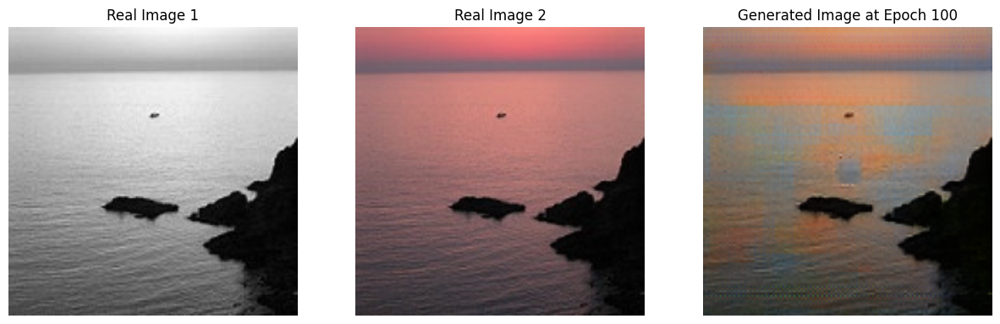

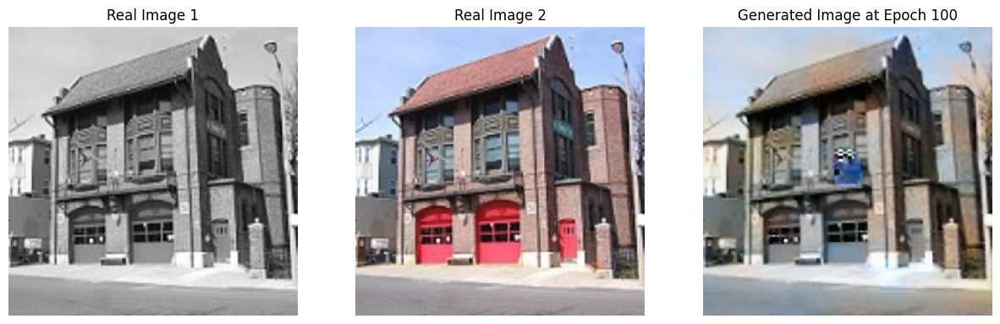

Treinamento concluído!


In [12]:
from matplotlib import pyplot as plt

# Instanciando o modelo GAN
gan = PaisagemGAN(generator=gene, discriminator=disc)
gan = gan.to(device)
gan.compile(g_loss=g_loss, d_loss=d_loss)

# Número de épocas
num_epochs = 100


# Loop de treinamento
print("Iniciar treinamento")
g_losses = []
d_losses = []
val_losses = []
for epoch in range(num_epochs):
    i = 0
    inicio = time.time()
    train_g_loss = 0.0
    train_d_loss = 0.0
    for batch in train_loader:
        real_images = normalize(batch[1].to(device))
        grey_images = normalize(batch[0].to(device))
        loss = gan.train_step(real_images, grey_images)
        i += 1
        train_g_loss += loss['g_loss']
        train_d_loss += loss['d_loss']
        real_images.cpu()
        grey_images.cpu()
    g_losses.append(train_g_loss/len(train_loader))
    d_losses.append(train_d_loss/len(train_loader))
    
    # Avaliação no conjunto de validação
    val_loss = 0.0
    with torch.no_grad():
        for val_batch in val_loader:
            val_real_images = normalize(val_batch[1].to(device))
            val_grey_images = normalize(val_batch[0].to(device))
            val_fake_images = gan.generator(val_grey_images)
            val_yhat_fake = gan.discriminator(val_fake_images)
            last_v_loss = g_loss(val_yhat_fake, val_fake_images, val_real_images)
            val_loss += last_v_loss.item()
            val_real_images.cpu()
            val_grey_images.cpu()
    
    val_loss /= len(val_loader)
    val_losses.append(val_loss)
    
    print(f"Epoch [{epoch+1}/{num_epochs}], d_loss: {loss['d_loss']:.4f}, g_loss: {loss['g_loss']:.4f}, val_loss: {val_loss:.4f}")
    fim = time.time()
    print(fim - inicio)

    if (epoch+1) % 5 == 0 or (epoch) == 0:
        save_checkpoint(gan.generator, gan.g_opt, epoch, batch, loss, filepath='/kaggle/working/gen.pth')
        save_checkpoint(gan.discriminator, gan.d_opt, epoch, batch, loss, filepath='/kaggle/working/disc.pth')

        # Desenhando evoluçao do treinamento
        # Convertendo as imagens geradas de 0-1 para 0-255
        gen_image = (loss['gen'][0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')

        # Convertendo batch[0] e batch[1] de 0-1 para 0-255
        real_image1 = (batch[0][0].detach().cpu().numpy().squeeze()*255).astype('uint8')
        real_image2 = (batch[1][0].detach().cpu().numpy().transpose(1, 2, 0)*255 ).astype('uint8')

        # Plotando as três imagens lado a lado
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(real_image1, cmap='gray')
        axes[0].set_title("Real Image 1")

        axes[1].imshow(real_image2)
        axes[1].set_title("Real Image 2")

        axes[2].imshow(gen_image)
        axes[2].set_title(f"Generated Image at Epoch {epoch + 1}")

        for ax in axes:
            ax.axis('off')  # Remove os eixos

        plt.show()

        # Desenhando evolução da validação
        # Convertendo as imagens geradas de 0-1 para 0-255
        gen_image = (val_fake_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')

        # Convertendo batch[0] e batch[1] de 0-1 para 0-255
        real_image1 = (val_grey_images[0].detach().cpu().numpy().squeeze()*255).astype('uint8')
        real_image2 = (val_real_images[0].detach().cpu().numpy().transpose(1, 2, 0)*255 ).astype('uint8')

        # Plotando as três imagens lado a lado
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(real_image1, cmap='gray')
        axes[0].set_title("Real Image 1")

        axes[1].imshow(real_image2)
        axes[1].set_title("Real Image 2")

        axes[2].imshow(gen_image)
        axes[2].set_title(f"Generated Image at Epoch {epoch + 1}")

        for ax in axes:
            ax.axis('off')

        plt.show()
        

print("Treinamento concluído!")


In [13]:
#torch.cuda.empty_cache()
print(val_losses)

[7.1656412336561415, 7.2730533017052545, 6.884073215060764, 6.508026064766778, 6.613879373338487, 6.557685942120022, 6.32658814324273, 6.185832813051012, 6.831447887420654, 6.406893343395657, 6.3470205042097305, 6.476459333631728, 6.308079242706299, 6.348112042744955, 6.134913804796007, 6.190606360965305, 5.912557310528225, 5.9903558360205755, 6.038757265938653, 6.004247442881266, 6.2236221631368, 6.586045000288221, 5.994635179307726, 5.79170241355896, 6.155653095245361, 5.963029289245606, 5.69498430887858, 6.275997675789727, 5.846939431296454, 5.994917005962796, 6.002595308091905, 6.123916610081991, 5.958813614315456, 5.802708254920112, 5.952159950468276, 5.9333500915103485, 5.854142898983426, 5.81716676818, 6.401122792561849, 5.7075676229265, 5.924814112981161, 6.021141131718953, 6.110017702314589, 5.773324415418837, 6.006711626052857, 5.9191496319241, 6.111094077428182, 5.918409612443712, 6.070622656080458, 6.002388207117717, 5.957826540205214, 5.8780289649963375, 6.033578072653876,

In [14]:
import csv

# Caminho do arquivo onde as perdas serão salvas
loss_file_path = '/kaggle/working/losses.csv'

# Função para salvar as perdas em um arquivo CSV
def save_losses_to_csv(g_losses, d_losses, val_losses, file_path):
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Epoch', 'G Loss', 'D Loss', 'Validation Loss'])
        for epoch, (g, d, val_loss) in enumerate(zip(g_losses, d_losses, val_losses), start=1):
            writer.writerow([epoch, g, d, val_loss])

# Salvar as perdas
save_losses_to_csv(g_losses, d_losses, val_losses, loss_file_path)

print(f"Losses saved to {loss_file_path}")

Losses saved to /kaggle/working/losses.csv


In [15]:
# Caminho para a pasta de teste
test_color_dir = "/kaggle/input/test-color10"
test_gray_dir = "/kaggle/working/test_gray10"
os.makedirs(test_gray_dir, exist_ok=True)

# Listar imagens de teste
test_color_images = sorted(os.listdir(test_color_dir))

# Função para converter e salvar imagens em escala de cinza
def convert_to_grayscale_and_save(image_path, save_dir):
    image = Image.open(image_path).convert("L")  # Converte para escala de cinza
    base_name = os.path.basename(image_path)
    save_path = os.path.join(save_dir, base_name)
    image.save(save_path)

# Converter e salvar todas as imagens coloridas como monocromáticas
for img_name in test_color_images:
    img_path = os.path.join(test_color_dir, img_name)
    convert_to_grayscale_and_save(img_path, test_gray_dir)

print("Imagens monocromáticas geradas e salvas com sucesso!")

Imagens monocromáticas geradas e salvas com sucesso!


torch.Size([1, 1, 256, 256])


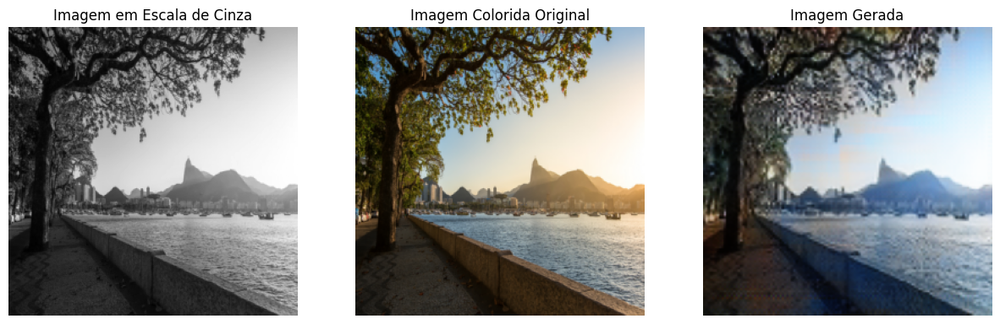

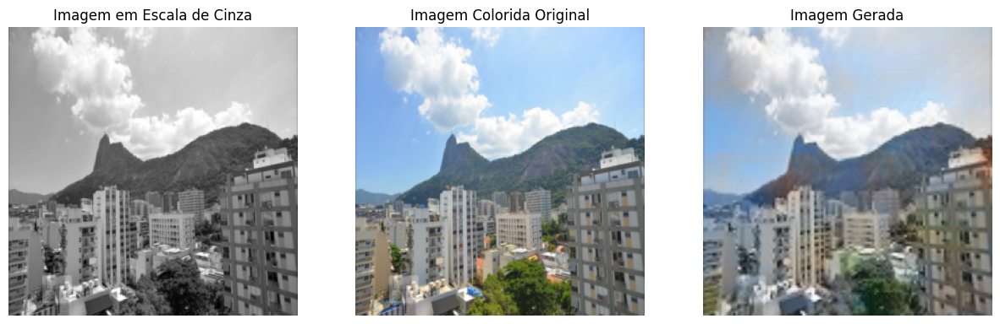

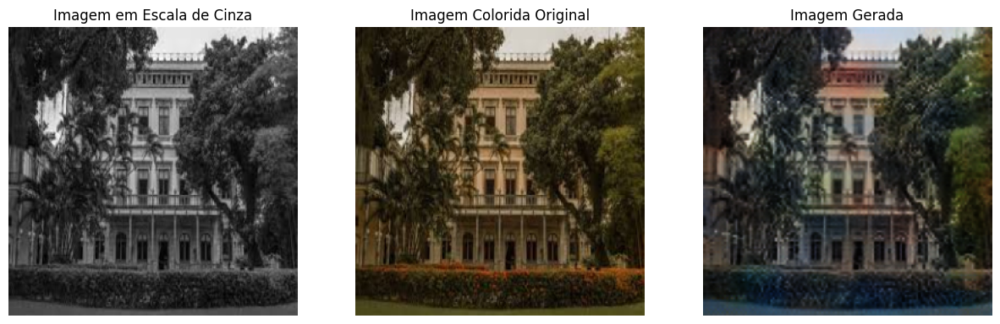

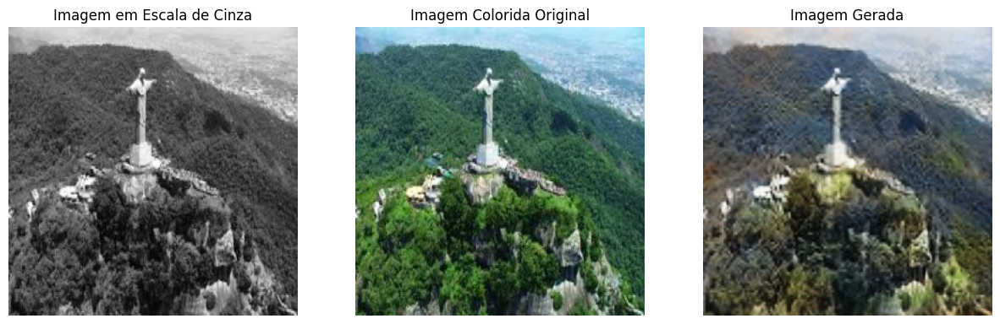

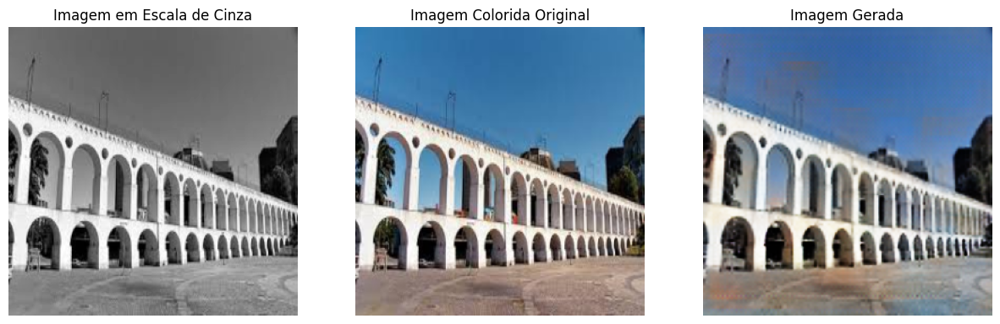

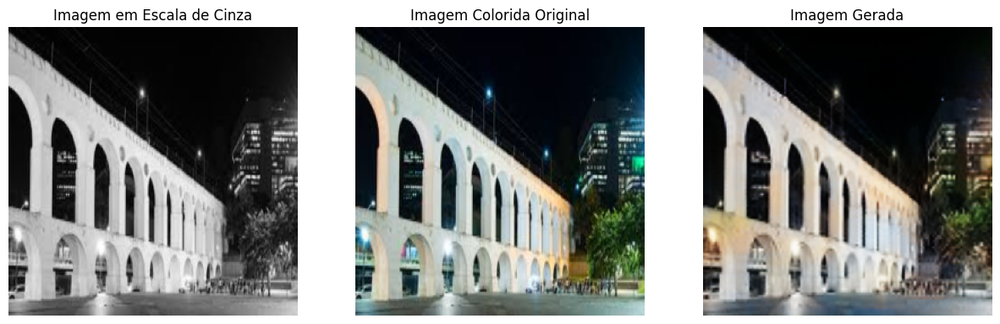

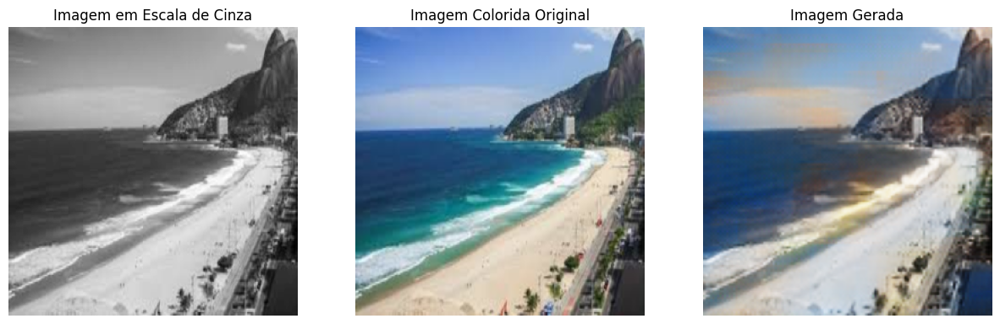

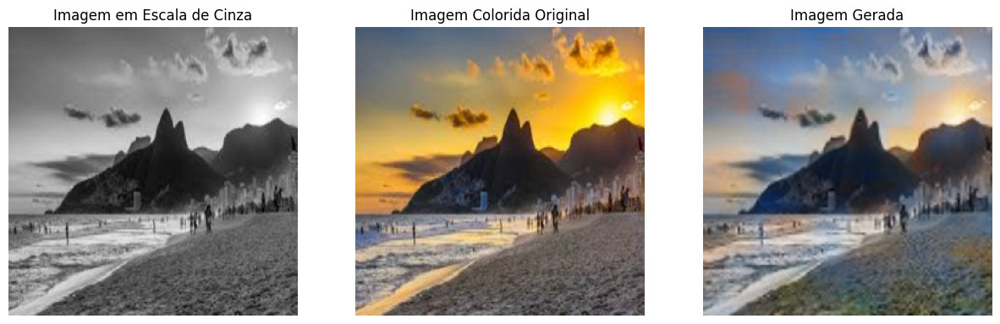

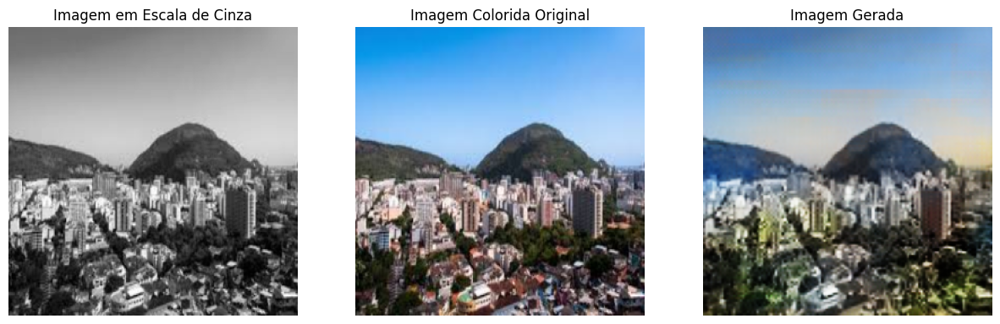

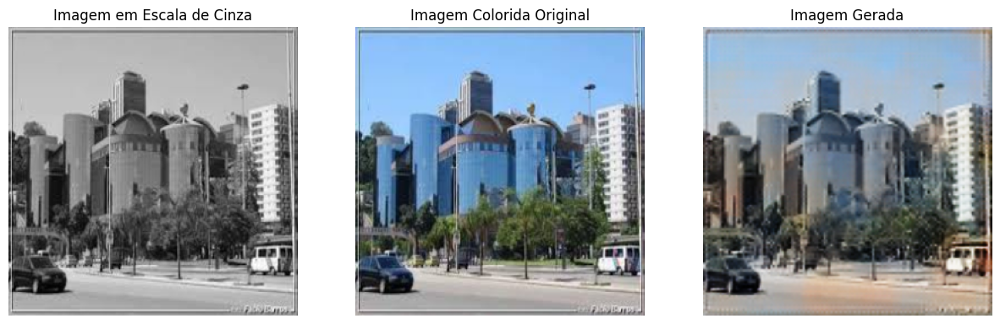

In [16]:
import os
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt

# Definir o dispositivo (GPU se disponível, caso contrário, CPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Definir o dataset customizado que converte a imagem colorida para cinza diretamente
class CustomDataset(Dataset):
    def __init__(self, gray_dir, color_dir, image_names, transform=None):
        self.color_dir = color_dir
        self.image_names = image_names
        self.transform = transform

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        image_name = self.image_names[idx]
        # Caminho para a imagem colorida
        color_image_path = os.path.join(self.color_dir, image_name + '.jpeg')

        # Carregar a imagem colorida e convertê-la para cinza
        color_image = Image.open(color_image_path).convert('RGB')
        gray_image = color_image.convert('L')  # Converte para escala de cinza

        # Aplicar as transformações
        if self.transform:
            gray_image = self.transform(gray_image)
            color_image = self.transform(color_image)

        return gray_image, color_image

# Definir as transformações de pré-processamento
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Tamanho da imagem esperado
    transforms.ToTensor(),  # Converte a imagem para tensor
])

# Caminho para a pasta de teste
test_color_dir = "/kaggle/input/test-color10"

# Listar imagens de teste
test_color_images = sorted(os.listdir(test_color_dir))

# Extraindo nomes dos arquivos (sem a extensão)
test_image_names = [os.path.splitext(img)[0] for img in test_color_images]

# Criando dataset de teste
test_dataset = CustomDataset(None, test_color_dir, test_image_names, transform=transform)

# Criando DataLoader de teste
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=4, pin_memory=True)

# Pegar as dimensões de uma amostra de imagem
nex = next(iter(test_loader))
img_dim = nex[0].shape
print(img_dim)

# Mover o gerador para o dispositivo (GPU ou CPU)
generator = gene.to(device)

# Colocar o gerador no modo de avaliação (para desativar dropout e batchnorm)
generator.eval()

# Gerar novas imagens e exibir os resultados
for gray_image, color_image in test_loader:
    # Mover a imagem em escala de cinza para o dispositivo (GPU ou CPU)
    gray_image = gray_image.to(device)

    with torch.no_grad():  # Desativa o cálculo do gradiente para a inferência
        generated_image = generator(gray_image)

    # Pós-processamento (se necessário)
    generated_image = generated_image.squeeze(0)  # Remove a dimensão de lote
    #generated_image = (generated_image * 0.5) + 0.5  # Desfaz a normalização [-1, 1] -> [0, 1]
    generated_image = generated_image.cpu().numpy().transpose(1, 2, 0)  # Converte para numpy e rearranja dimensões
    generated_image = (generated_image * 255).astype('uint8')  # Reescala para [0, 255] e converte para uint8


    # Exibir as imagens (gray_image, color_image, generated_image)
    plt.figure(figsize=(15, 5))

    # Mostrar a imagem em escala de cinza
    plt.subplot(1, 3, 1)
    plt.imshow(gray_image.squeeze().cpu(), cmap='gray')  # Remover a dimensão extra
    plt.title('Imagem em Escala de Cinza')
    plt.axis('off')

    # Mostrar a imagem colorida original
    plt.subplot(1, 3, 2)
    plt.imshow(color_image.squeeze(0).permute(1, 2, 0).cpu())  # Corrigir permutação para (H, W, C)
    plt.title('Imagem Colorida Original')
    plt.axis('off')

    # Mostrar a imagem gerada
    plt.subplot(1, 3, 3)
    plt.imshow(generated_image)
    plt.title('Imagem Gerada')
    plt.axis('off')

    plt.show()
